In [1]:
import traffic
from traffic.data import opensky
from traffic.drawing import EuroPP, PlateCarree, countries, rivers
import matplotlib.pyplot as plt
import xarray
import pickle as pkl
import numpy as np
import joblib as jl


In [2]:
bounds = (-2.3, 50.5, -0.5, 51.3)
if input() == 'yes': # prevent this running accidentally!
    soton_tfc = opensky.history( 
        "2019-01-01 00:00",
        "2020-01-01 00:00",
        bounds=bounds,
        other_params=' and geoaltitude<=1524 and onground=false ')
    soton_tfc.to_pickle("soton_tfc_raw_lt5000ft_2019.pkl")
    soton_tfc_clean = soton_tfc.clean_invalid().assign_id().filter().resample('10s').eval(desc='', max_workers=8)
    soton_tfc_clean.to_pickle("soton_tfc_clean_lt5000ft_2019.pkl")
    

C:\Anaconda3\envs\tfc\lib\site-packages\ipykernel\ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [2]:
# with open("soton_tfc_clean_lt5000ft.pkl", 'rb') as f:
# soton_tfc_clean = traffic.core.Traffic.from_file("soton_tfc_clean_lt5000ft.pkl")
soton_tfc_clean = traffic.core.Traffic.from_file("soton_tfc_clean_lt5000ft_2019.pkl")
soton_tfc_clean = soton_tfc_clean.query('latitude<51.2')

C:\Anaconda3\envs\tfc\lib\site-packages\ipykernel\ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [7]:
# with plt.style.context('traffic'):
#     fig, ax = plt.subplots(
#         subplot_kw=dict(projection=EuroPP())
#     )
#     ax.add_feature(countries())
#     ax.add_feature(rivers())
#     soton_tfc_clean.plot(ax)


AttributeError: 'Traffic' object has no attribute 'head'

In [6]:

soton_tfc_clean.to_json("states.json", index=False)

ValueError: 'index=False' is only valid when 'orient' is 'split' or 'table'

In [40]:
z_res = 152#m ~= 500ft
z_floor = 0 # min altitude
z_ceiling = 1524 # max altitude from openSky query above

# Create (lower, upper) bound pairs for queries
zs = list(range(z_floor, z_ceiling, z_res))
z_limit_pairs = list(zip(zs, zs[1:])) # generated for later

data = soton_tfc_clean

z_layer_data = []
for lower, upper in z_limit_pairs:
    z_layer_data.append(data.query(f'altitude>{lower} and altitude<={upper}'))

In [41]:
# The data is a full year and 2019 is not a leap year so...
hours = 365 * 24
# Crudely assume that half of those are daylight hours and the other half night
day_hours = night_hours = hours/2

C:\Anaconda3\envs\tfc\lib\site-packages\ipykernel\ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [42]:
# dimension resolutions
rlat = 150
rlon = 150

layer_rasters = []
for i, data in enumerate(z_layer_data):
    layer_raster = data.agg_latlon(
            resolution=dict(latitude=rlat, longitude=rlon),
            # count the number of flights
            flight_id="nunique"
            ).to_xarray()
    layer_rasters.append(layer_raster)

C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(


In [43]:
import shapely.geometry as sg
from pyproj import Transformer
tr = Transformer.from_crs('EPSG:4326', 'EPSG:3857', always_xy=True)
tr_layer_rasters = []

for layer in layer_rasters:
    lons, lats = np.meshgrid(layer.longitude, layer.latitude)
    tr_lon, tr_lat = tr.transform(lons, lats)
    tr_lat = tr_lat[:, 0]
    tr_lon = tr_lon[0, :]
    
    poly_areas = []
    for idx_lat, t_lat in np.ndenumerate(tr_lat[:-1]):
        lat_areas = []
        b_lat = tr_lat[idx_lat[0]+1]
        for idx_lon, l_lon in np.ndenumerate(tr_lon[:-1]):
            r_lon = tr_lon[idx_lon[0]+1]
            poly = sg.box(l_lon, b_lat, r_lon, t_lat)
            lat_areas.append(poly.area)
            
        # Repeat final elements to fill in gaps and index correctly
        # For small areas the error this introduces is negligible
        lat_areas.append(lat_areas[-1])
        
        poly_areas.append(lat_areas)
    poly_areas.append(poly_areas[-1])
    # Now that we have the area of each pixel we can find the volume that each layer increment has
    raster_vols = np.array(poly_areas) * z_res
    tr_layer_rasters.append(layer/(raster_vols * hours))

In [44]:
layer_rasters

[<xarray.Dataset>
 Dimensions:    (latitude: 106, longitude: 252)
 Coordinates:
   * latitude   (latitude) float64 50.5 50.51 50.51 50.52 ... 51.19 51.19 51.2
   * longitude  (longitude) float64 -2.3 -2.293 -2.287 ... -0.5133 -0.5067 -0.5
 Data variables:
     flight_id  (latitude, longitude) float64 nan nan nan nan ... nan nan nan nan,
 <xarray.Dataset>
 Dimensions:    (latitude: 106, longitude: 269)
 Coordinates:
   * latitude   (latitude) float64 50.5 50.51 50.51 50.52 ... 51.19 51.19 51.2
   * longitude  (longitude) float64 -2.3 -2.293 -2.287 ... -0.5133 -0.5067 -0.5
 Data variables:
     flight_id  (latitude, longitude) float64 nan nan nan nan ... nan nan nan nan,
 <xarray.Dataset>
 Dimensions:    (latitude: 106, longitude: 271)
 Coordinates:
   * latitude   (latitude) float64 50.5 50.51 50.51 50.52 ... 51.19 51.19 51.2
   * longitude  (longitude) float64 -2.3 -2.293 -2.287 ... -0.5133 -0.5067 -0.5
 Data variables:
     flight_id  (latitude, longitude) float64 nan nan nan nan ... 

<ipython-input-9-542a1412f062>:19: DeprecationWarning: The background_patch property is deprecated. Use GeoAxes.patch instead.
  ax_.background_patch.set_facecolor("#eeeeee")
<ipython-input-9-542a1412f062>:19: DeprecationWarning: The background_patch property is deprecated. Use GeoAxes.patch instead.
  ax_.background_patch.set_facecolor("#eeeeee")


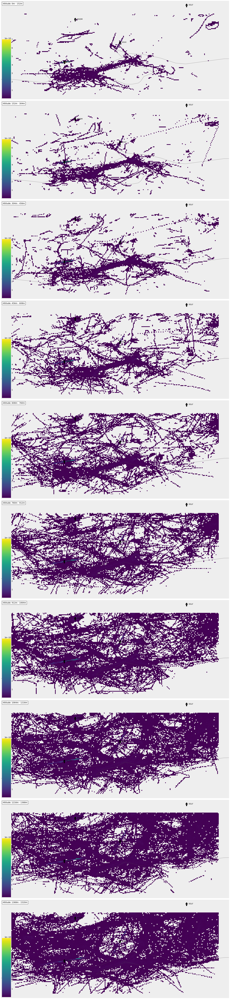

In [9]:
from matplotlib.offsetbox import AnchoredText
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

from traffic.data import airports
from traffic.drawing import countries, ocean, EuroPP, PlateCarree
from traffic.drawing.markers import rotate_marker, atc_tower, aircraft


layer_rasters = []

with plt.style.context("traffic"):

    fig = plt.figure(figsize=(150, 100), frameon=False)
    ax = fig.subplots(len(z_layer_data), 1, subplot_kw=dict(projection=PlateCarree()))


    for ax_ in ax:
        ax_.add_feature(countries(scale="50m", linewidth=1.5))
        ax_.background_patch.set_facecolor("#eeeeee")
        for name in "EGHI EGHH EGLF EGDM".split():
            bbox = dict(
                facecolor="green", edgecolor="green", alpha=0.6, boxstyle="round"
            )
            airports[name].point.plot(ax_, marker=atc_tower, s=500, zorder=5)

    vmax = None  # this trick will keep the same colorbar scale for both maps

    for i, layer_raster in enumerate(tr_layer_rasters):
#         layer_raster = data.agg_latlon(
#                 resolution=dict(latitude=nlat, longitude=nlon),
#                 # count the number of flights
#                 flight_id="nunique"
#                 ).to_xarray() / premult# Normalise by volume and time
#         layer_rasters.append(layer_raster)
        cax = (
            layer_raster
            .flight_id.plot.pcolormesh(
                ax=ax[i],
                cmap="viridis",
                transform=PlateCarree(),
                vmax=vmax,
                add_colorbar=False,
            )
        )

        cbaxes = inset_axes(ax[i], "4%", "60%", loc=3)
        cb = fig.colorbar(cax, cax=cbaxes)

        # keep this value to scale the colorbar for the second day
        vmax = cb.vmax

        text = AnchoredText(
            f"Altitude: {z_limit_pairs[i][0]}m - {z_limit_pairs[i][1]}m",
            loc=2,
            prop={"size": 14, "fontname": "Ubuntu"},
            frameon=True,
        )
        text.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
        ax[i].add_artist(text)

    fig.set_tight_layout(True)

In [46]:
!conda install -y rasterio

Solving environment: ...working... failed with initial frozen solve. Retrying with flexible solve.
Solving environment: ...working... failed with repodata from current_repodata.json, will retry with next repodata source.
Solving environment: ...working... failed with initial frozen solve. Retrying with flexible solve.
Solving environment: ...working... 
Found conflicts! Looking for incompatible packages.
This can take several minutes.  Press CTRL-C to abort.
failed



Examining rasterio:  80%|########  | 4/5 [00:00<00:00, 102.57it/s]               
                                                                  

Examining conflict for python rasterio:   0%|          | 0/5 [00:00<?, ?it/s]
                                                                             

UnsatisfiableError: The following specifications were found
to be incompatible with the existing python installation in your environment:

Specifications:

  - rasterio -> python[version='>=2.7,<2.8.0a0|>=3.5,<3.6.0a0|>=3.6,<3.7.0a0|>=3.7,<3.8.0a0']

Your python: python=3.9

If python is on the left-most side of the chain, that's the version you've asked for.
When python appears to the right, that indicates that the thing on the left is somehow
not available for the python version you are constrained to. Note that conda will not
change your python version to a different minor version unless you explicitly specify
that.





C:\Anaconda3\envs\tfc\lib\site-packages\ipykernel\ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-10-a09f8201cc0f>:13: DeprecationWarning: The background_patch property is deprecated. Use GeoAxes.patch instead.
  ax.background_patch.set_facecolor("#eeeeee")
C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(


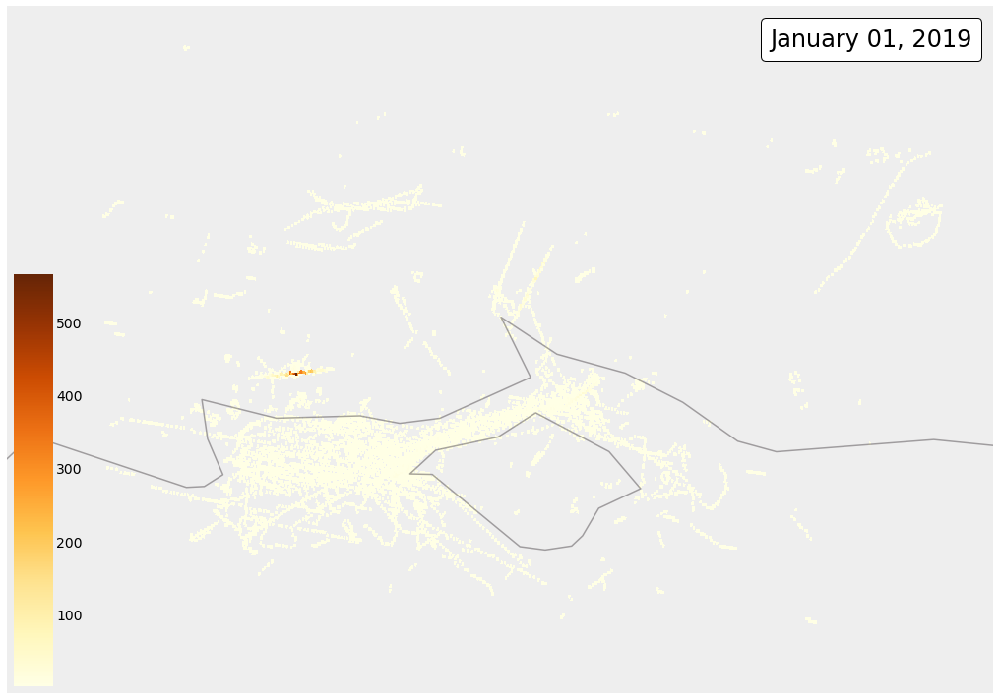

In [10]:
from matplotlib.offsetbox import AnchoredText
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

from traffic.drawing import countries, ocean, EuroPP, PlateCarree


with plt.style.context("traffic"):

    fig = plt.figure(figsize=(15, 10), frameon=False)
    ax = fig.subplots(1, 1, subplot_kw=dict(projection=EuroPP()))

    ax.add_feature(countries(scale="50m", linewidth=1.5))
    ax.background_patch.set_facecolor("#eeeeee")

    vmax = None  # this trick will keep the same colorbar scale for both maps

    data = z_layer_data[0]
    cax = (
        data
        .agg_latlon(
            resolution=dict(latitude=300, longitude=300),
            # count the number of flights
            flight_id="nunique"
        ) 
        .to_xarray()
        .flight_id.plot.pcolormesh(
            ax=ax,
            cmap="YlOrBr",
            transform=PlateCarree(),
            vmax=vmax,
            add_colorbar=False,
        )
    )

    cbaxes = inset_axes(ax, "4%", "60%", loc=3)
    cb = fig.colorbar(cax, cax=cbaxes)

    # keep this value to scale the colorbar for the second day
    vmax = cb.vmax

    text = AnchoredText(
        f"{data.start_time:%B %d, %Y}",
        loc=1,
        prop={"size": 24, "fontname": "Ubuntu"},
        frameon=True,
    )
    text.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
    ax.add_artist(text)

    fig.set_tight_layout(True)

C:\Anaconda3\envs\tfc\lib\site-packages\ipykernel\ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
C:\Anaconda3\envs\tfc\lib\site-packages\holoviews\operation\datashader.py:5: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3, and in 3.10 it will stop working
  from collections import Callable
C:\Anaconda3\envs\tfc\lib\site-packages\nbconvert\exporters\html.py:100: DeprecationWarning: 'contextfilter' is renamed to 'pass_context', the old name will be removed in Jinja 3.1.
  def markdown2html(self, context, source):
C:\Anaconda3\envs\tfc\lib\site-packages\panel\io\resources.py:39: DeprecationWarning: 'jinja2.Markup' is deprecated and will be removed in Ji

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
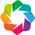

In [11]:
import holoviews as hv
import geoviews as gv
import bokeh
import panel as pn
hv.extension('bokeh')

In [12]:
hmap = hv.HoloMap(
    {f"{z_limit_pairs[i][0]}m - {z_limit_pairs[i][1]}m" : gv.QuadMesh(np.log10(tr_layer_rasters[i]), kdims=['longitude', 'latitude']).opts(alpha=0.8, clipping_colors={'NaN': 'transparent'}, colorbar=True, colorbar_opts={'title': "Log10 Traffic Density [log10 m^−3 . h^−1]"}, cmap='viridis') 
     for i in range(len(tr_layer_rasters))},
    kdims='Altitude')
tiles = gv.tile_sources.OSM
plot = (tiles * hmap).opts(width=600, height=550, active_tools=['wheel_zoom'])
plot
# hv.save(plot, 'soton_air_tfc_density_2019.html', backend='bokeh')

C:\Anaconda3\envs\tfc\lib\site-packages\ipykernel\ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


:HoloMap   [Altitude]
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .QuadMesh.I :QuadMesh   [longitude,latitude]   (flight_id)

## Time based traffic

In [20]:
from tqdm import tqdm
import time
from calendar import timegm
start_epoch = timegm(time.strptime("2019-01-01 00:00", '%Y-%m-%d %H:%M'))
end_epoch = timegm(time.strptime("2020-01-01 00:00", '%Y-%m-%d %H:%M'))

sec_in_hour = 60**2
sec_in_day = 60*60*24
hour_epochs = []
for h in range(24):
    hour_epochs.append(np.arange(start_epoch + (h*sec_in_hour), end_epoch, sec_in_day))

hour_epochs[0][:5]

array([1546300800, 1546387200, 1546473600, 1546560000, 1546646400])

In [21]:
def traj_between(start, end):
    out = []
    out_append = out.append
    for f in soton_tfc_clean:
        t = f.between(start, end)
        if t:
            out_append(t)
    return out

In [8]:
from tqdm import tqdm
from joblib import Parallel, delayed

year_hour_trajectories = []
for hour in tqdm(range(24)):
    hour_traj = []
    start_end_pairs = []
    for day in range(21):
        start = hour_epochs[hour][day]
        end = hour_epochs[(hour+1)%24][day]
        start_end_pairs.append((start,end))
    hour_traj = Parallel(n_jobs=-1)(delayed(traj_between)(s,e) for s, e in tqdm(start_end_pairs))
    year_hour_trajectories.append(hour_traj)

100%|██████████████████████████████████████████████████████████████████████████████| 24/24 [7:43:14<00:00, 1158.09s/it]


In [16]:
yht = year_hour_trajectories

In [9]:
with open('3_week_hour_traj.pkl', 'wb') as f:
    pkl.dump(year_hour_trajectories, f)

In [13]:
with open('3_week_hour_traj.pkl', 'rb') as f:
    year_hour_trajectories = pkl.load(f)

C:\Anaconda3\envs\tfc\lib\site-packages\ipykernel\ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
from traffic.core import Flight
[f[0] for f in year_hour_trajectories[5] if f][0].latitude

In [17]:
from traffic.core import Traffic
hour_traffics = []
for hour in range(24):
    ttft = Traffic.from_flights([f[0] for f in yht[hour] if f])
    if ttft:
        hour_traffics.append(ttft)
    else:
        hour_traffics.append([])

In [18]:
hour_traffics[23]

[]

In [22]:
# dimension resolutions
rlat = 150
rlon = 150

hour_rasters = []
for hour_data in tqdm(hour_traffics):
    z_layer_data = []
    if not hour_data:
        hour_rasters.append([])
        continue
    for lower, upper in z_limit_pairs:
        z_layer_data.append(hour_data.query(f'altitude>{lower} and altitude<={upper}'))

        layer_rasters = []
        for i, data in enumerate(z_layer_data):
            if data:
                layer_raster = data.agg_latlon(
                        resolution=dict(latitude=rlat, longitude=rlon),
                        # count the number of flights
                        flight_id="nunique"
                        ).to_xarray()
                layer_rasters.append(layer_raster)
    hour_rasters.append(layer_rasters)

  0%|                                                                                           | 0/24 [00:00<?, ?it/s]C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\

 33%|███████████████████████████▋                                                       | 8/24 [00:01<00:02,  7.23it/s]C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\

C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
 54%|████████████████████████████████████████████▍                                     | 13/24 [00:02<00:03,  3.36it/s]C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\

C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
 75%|█████████████████████████████████████████████████████████████▌                    | 18/24 [00:04<00:02,  2.98it/s]C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
C:\Anaconda3\envs\tfc\lib\

C:\Anaconda3\envs\tfc\lib\site-packages\traffic\core\traffic.py:827: DeprecationWarning: agg_latlon will disappear in future versions. Use agg_xy instead
  warnings.warn(
100%|██████████████████████████████████████████████████████████████████████████████████| 24/24 [00:06<00:00,  3.94it/s]


In [27]:
import shapely.geometry as sg
from pyproj import Transformer
tr = Transformer.from_crs('EPSG:4326', 'EPSG:3857', always_xy=True)
tr_hour_rasters = []
for hour in range(24):
    tr_layer_rasters = []
    for layer in hour_rasters[hour]:
        print(len(layer))
        print(len(layer.latitude))
        lons, lats = np.meshgrid(layer.longitude, layer.latitude)
        tr_lon, tr_lat = tr.transform(lons, lats)
        tr_lat = tr_lat[:, 0]
        tr_lon = tr_lon[0, :]

        poly_areas = []
        for idx_lat, t_lat in np.ndenumerate(tr_lat[:-1]):
            lat_areas = []
            b_lat = tr_lat[idx_lat[0]+1]
            for idx_lon, l_lon in np.ndenumerate(tr_lon[:-1]):
                r_lon = tr_lon[idx_lon[0]+1]
                poly = sg.box(l_lon, b_lat, r_lon, t_lat)
                lat_areas.append(poly.area)

            # Repeat final elements to fill in gaps and index correctly
            # For small areas the error this introduces is negligible
            lat_areas.append(lat_areas[-1])

            poly_areas.append(lat_areas)
        if poly_areas:
            poly_areas.append(poly_areas[-1])
            # Now that we have the area of each pixel we can find the volume that each layer increment has
            raster_vols = np.array(poly_areas) * z_res
            tr_layer_rasters.append(layer/(raster_vols * hours))
    if tr_layer_rasters:
        tr_hour_rasters.append(tr_layer_rasters)

1
1
1
1
1
13
1
1
1
1
1
2
1
2
1
3
1
2
1
2
1
15
1
2
1
8
1
1
1
1
1
1
1
1
1
1
1
7
1
2


C:\Anaconda3\envs\tfc\lib\site-packages\ipykernel\ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


IndexError: list index out of range

In [ ]:
import holoviews as hv
import geoviews as gv

def getHourRaster(hour, alt):
    try:
        return gv.QuadMesh(np.log10(hour_rasters[hour][alt]))
    except IndexError:
        return None

kdims = [hv.Dimension(('hour', 'Hour')),
         hv.Dimension(('alt', 'Altitude'))]
timed_tfc_rasters = {(hour, alt) : getHourRaster(hour,alt) for hour in range(23) for alt in range(len(z_limit_pairs)-1)}
hmap = hv.HoloMap(timed_tfc_rasters, kdims=kdims).opts(alpha=0.8, clipping_colors={'NaN': 'transparent'}, colorbar=True, colorbar_opts={'title': "Log10 Traffic Density [log10 m^−3 . h^−1]"}, cmap='viridis') 
tiles = gv.tile_sources.OSM
plot = (tiles * hmap).opts(width=600, height=550, active_tools=['wheel_zoom'])
plot
# hv.save(plot, 'soton_air_tfc_density_2019.html', backend='bokeh')

########## Hour:  0
Skipping empty
########## Hour:  1


<ipython-input-25-b1e0f18646c9>:28: DeprecationWarning: The background_patch property is deprecated. Use GeoAxes.patch instead.
  ax_.background_patch.set_facecolor("#eeeeee")


########## Hour:  2
[<GeoAxesSubplot:>]
########## Hour:  3
Skipping empty
########## Hour:  4
########## Hour:  5
########## Hour:  6
########## Hour:  7
########## Hour:  8
########## Hour:  9
########## Hour:  10
########## Hour:  11
########## Hour:  12
########## Hour:  13
########## Hour:  14
########## Hour:  15
########## Hour:  16
########## Hour:  17
########## Hour:  18
########## Hour:  19
########## Hour:  20
########## Hour:  21
########## Hour:  22


<ipython-input-25-b1e0f18646c9>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(150, 100), frameon=False)


########## Hour:  23
Skipping empty


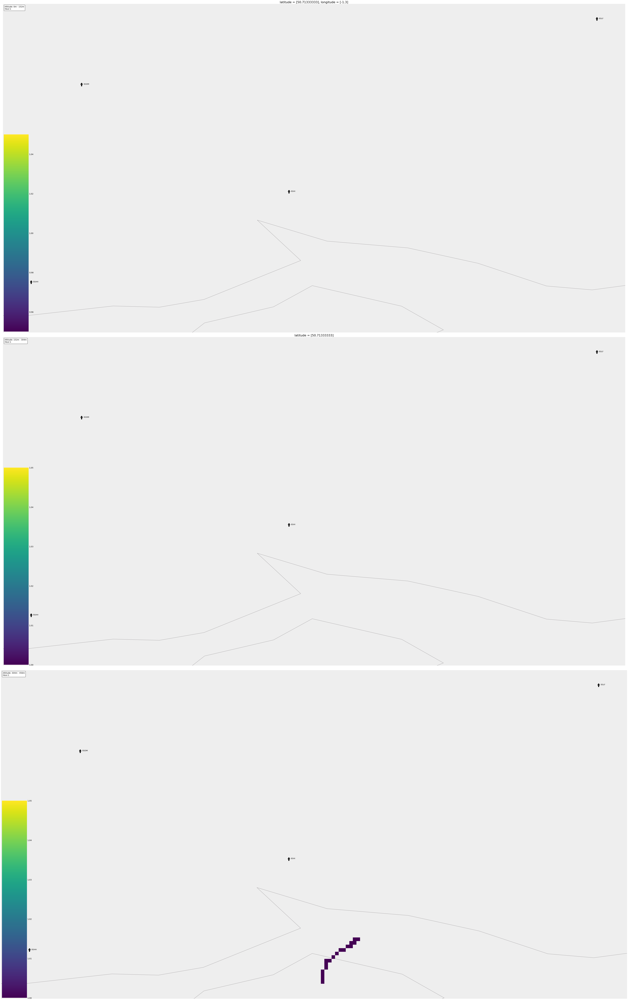

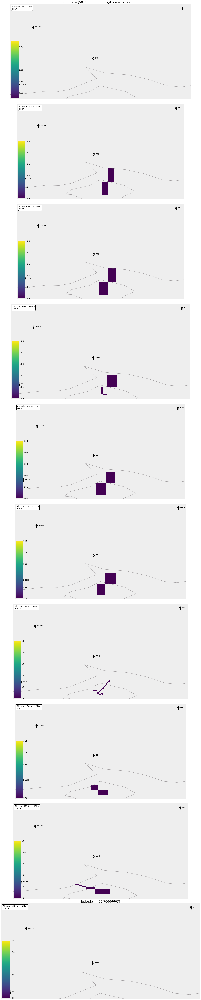

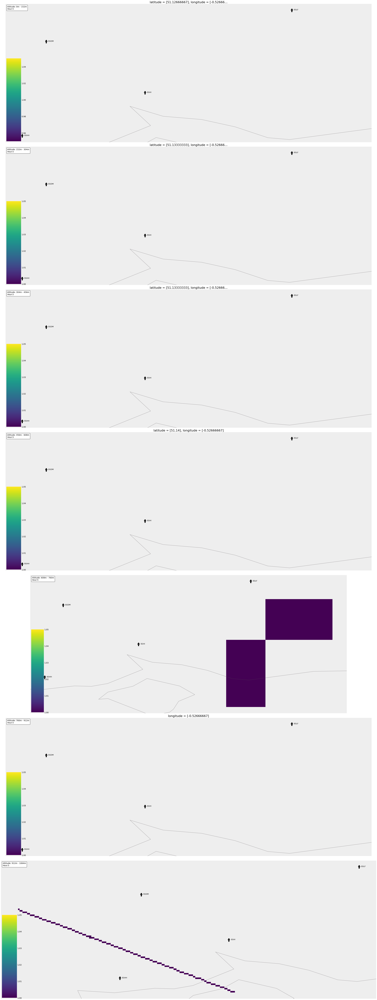

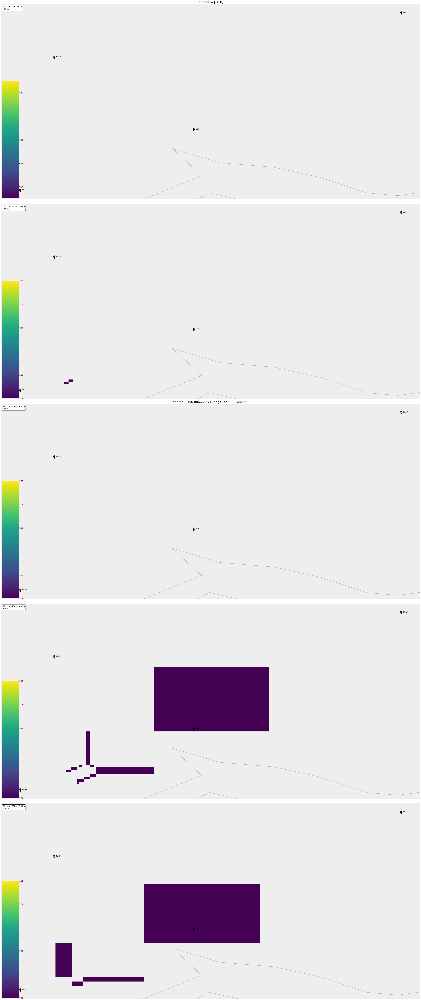

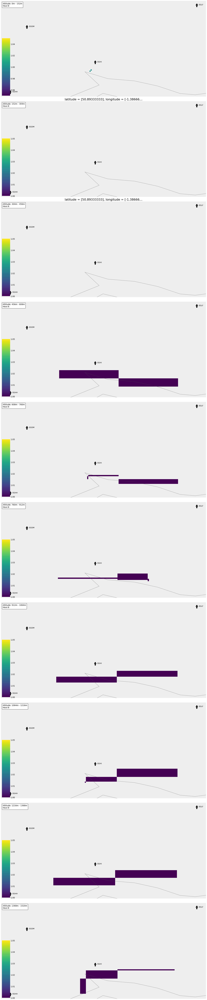

...

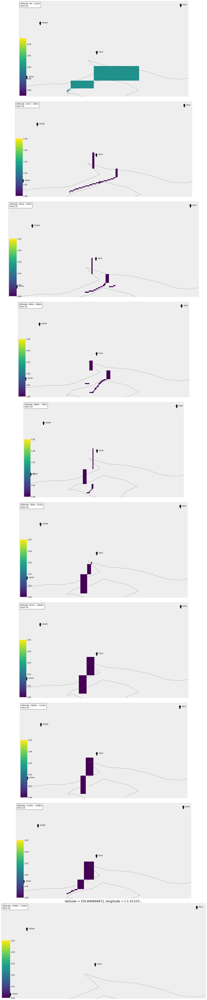

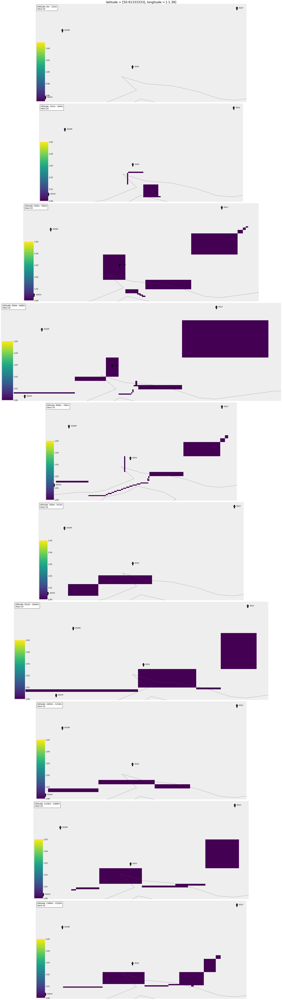

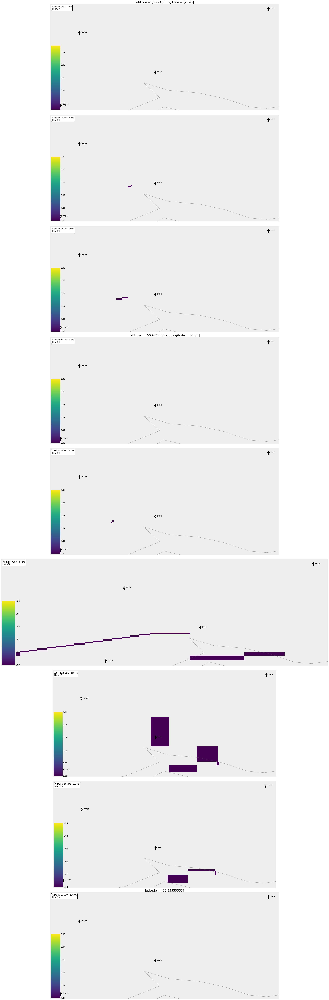

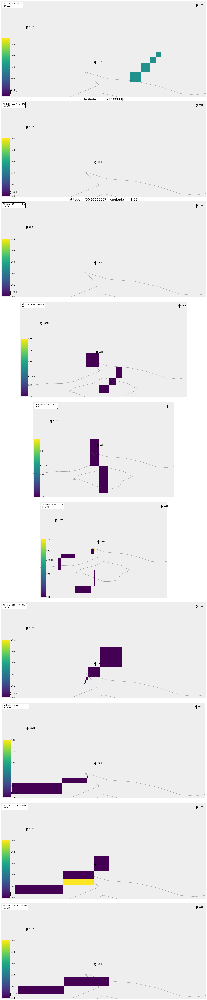

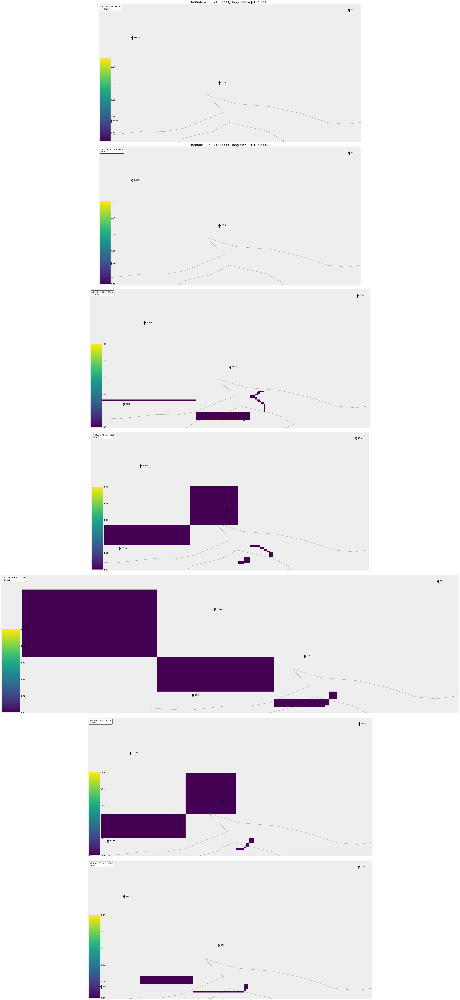

In [25]:
from matplotlib.offsetbox import AnchoredText
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

from traffic.data import airports
from traffic.drawing import countries, ocean, EuroPP, PlateCarree
from traffic.drawing.markers import rotate_marker, atc_tower, aircraft


layer_rasters = []

with plt.style.context("traffic"):
    
    for hour in range(24):
        print("########## Hour: ", hour)
        if len(hour_rasters[hour]) == 0:
            print("Skipping empty")
            continue

        fig = plt.figure(figsize=(150, 100), frameon=False)
        ax = fig.subplots(len(hour_rasters[hour]), 1, subplot_kw=dict(projection=PlateCarree()))
        
        if len(hour_rasters[hour]) == 1:
            ax = [ax]
            print(ax)

        for ax_ in ax:
            ax_.add_feature(countries(scale="50m", linewidth=1.5))
            ax_.background_patch.set_facecolor("#eeeeee")
            for name in "EGHI EGHH EGLF EGDM".split():
                bbox = dict(
                    facecolor="green", edgecolor="green", alpha=0.6, boxstyle="round"
                )
                airports[name].point.plot(ax_, marker=atc_tower, s=500, zorder=5)

        vmax = None  # this trick will keep the same colorbar scale for both maps

        for i, layer_raster in enumerate(hour_rasters[hour]):
    #         layer_raster = data.agg_latlon(
    #                 resolution=dict(latitude=nlat, longitude=nlon),
    #                 # count the number of flights
    #                 flight_id="nunique"
    #                 ).to_xarray() / premult# Normalise by volume and time
    #         layer_rasters.append(layer_raster)
            cax = (
                layer_raster
                .flight_id.plot.pcolormesh(
                    ax=ax[i],
                    cmap="viridis",
                    transform=PlateCarree(),
                    vmax=vmax,
                    add_colorbar=False,
                )
            )

            cbaxes = inset_axes(ax[i], "4%", "60%", loc=3)
            cb = fig.colorbar(cax, cax=cbaxes)

            # keep this value to scale the colorbar for the second day
            vmax = cb.vmax

            text = AnchoredText(
                f"Altitude: {z_limit_pairs[i][0]}m - {z_limit_pairs[i][1]}m\nHour:{hour}",
                loc=2,
                prop={"size": 14, "fontname": "Ubuntu"},
                frameon=True,
            )
            text.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
            ax[i].add_artist(text)

        fig.set_tight_layout(True)
        fig.show()